## Module 5 Assignment 2: Company Bankruptcy Prediction (Kaggle)
1. Conduct your analysis using a cross-validation design.
2. Conduct / improve upon previous EDA.
3. Build the following models at a minimum.
    1. Random Forest Classifier
    2. Gradient Boosted Trees
    3. Extra Trees
4. Conduct hyperparameter tuning for the following at a minimum.
    1. n_estimators (number of trees)
    2. max_features (maximum features considered for splitting a node)
    3. max_depth (maximum number of levels in each tree)
    4. splitting criteria (entropy or gini)
5. Compare your models using the F1-Score on a 20% validation set.
6. Generate predictions from your models, and submit at least two models to Kaggle.com for evaluation. Provide your Kaggle.com user name and a screen snapshot of your scores.  
### Python scikit-learn should be your primary environment for conducting this research.

In [48]:
import sys

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
#!conda install --yes xgboost
import xgboost

%matplotlib inline
import matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

#features
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, MinMaxScaler

#stats model
from sklearn import datasets, linear_model
import statsmodels.formula.api as smf

# Model Selection
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeClassifier
#!conda install --yes lightgbm
from lightgbm import LGBMClassifier
from sklearn.linear_model import LassoCV, LinearRegression
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, cross_val_score

# Model Accuracy
from sklearn import metrics
from sklearn.metrics import r2_score, accuracy_score, mean_poisson_deviance, mean_squared_error 

# Import librairies
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import KFold, cross_val_score, train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, LeaveOneOut
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.ensemble import RandomForestClassifier

import sklearn.metrics as metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score

from sklearn.tree import export_graphviz
import six
import sys
sys.modules['sklearn.externals.six'] = six
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus

# gradient boosting for classification in scikit-learn
from numpy import mean
from numpy import std
from sklearn.datasets import make_classification
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from matplotlib import pyplot

from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import ExtraTreesClassifier

pd.pandas.set_option('display.max_columns', None)
pd.pandas.set_option('display.max_rows', None)

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

In [2]:
df_train = pd.read_csv('bankruptcy.csv')
df_train_dup = df_train.copy()
df_train_dup.head()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.256969e-04,0.0,0.458143,0.000725,0.0,0.147950,0.147950,0.147950,0.169141,0.311664,0.017560,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,4.980000e+09,0.000327,0.263100,0.363725,0.002259,0.001208,0.629951,0.021266,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,0.001814,0.003487,1.820926e-04,1.165007e-04,0.032903,0.034164,0.392913,0.037135,0.672775,0.166673,0.190643,0.004094,0.001997,1.473360e-04,0.147308,0.334015,0.276920,0.001036,0.676269,0.721275,0.339077,0.025592,0.903225,0.002022,0.064856,7.010000e+08,6.550000e+09,0.593831,4.580000e+08,0.671568,0.424206,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.897851e-04,0.0,0.461867,0.000647,0.0,0.182251,0.182251,0.182251,0.208944,0.318137,0.021144,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,6.110000e+09,0.000443,0.264516,0.376709,0.006016,0.004039,0.635172,0.012502,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.397725,0.064468,0.001286,0.004917,9.360000e+09,7.190000e+08,0.025484,0.0068

In [3]:
df_train_dup.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt?                                                 6819 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

In [4]:
df_train_dup.shape

(6819, 96)

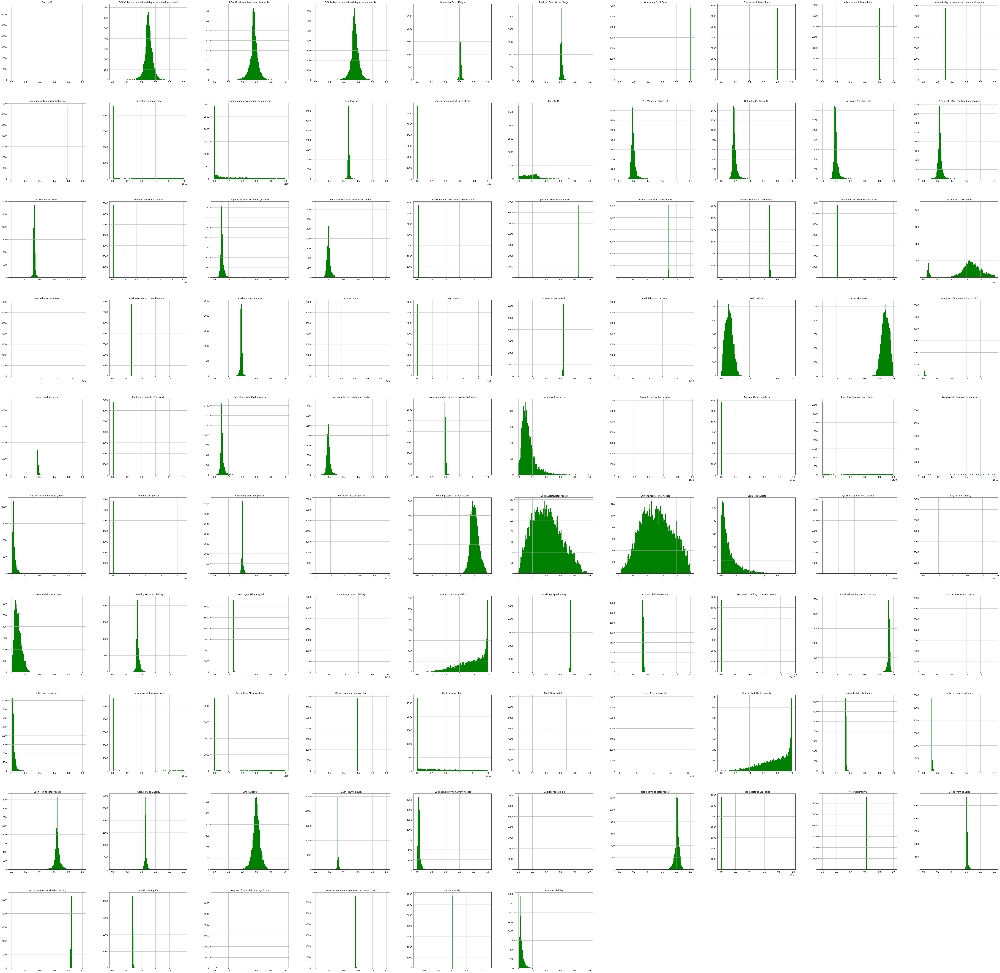

In [5]:
df_train_dup.hist(bins=100, figsize=(100,100),color='green')
plt.show()

In [6]:
df_train_dup['Bankrupt?'].describe()

count    6819.000000
mean        0.032263
std         0.176710
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: Bankrupt?, dtype: float64

In [7]:
df_train_dup['Bankrupt?'].value_counts(1)

0    0.967737
1    0.032263
Name: Bankrupt?, dtype: float64

In [8]:
df_train_dup.isnull().sum().any()

False

In [9]:
#sns.pairplot(df_train_dup,hue="Bankrupt?");

Index(['Bankrupt?', ' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)', ' Operating Expense Rate',
       ' Research and development expense rate', ' Cash flow rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Net Value Per Share (B)', ' Net Value Per Share (A)',
       ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons',
       ' Cash Flow Per Share', ' Revenue Per Share (Yuan ¥)',
       ' Operating Profit Per Share (Yuan ¥)',
       ' Per Share Net profit before tax (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Operating Profit

Count:  96


<AxesSubplot:>

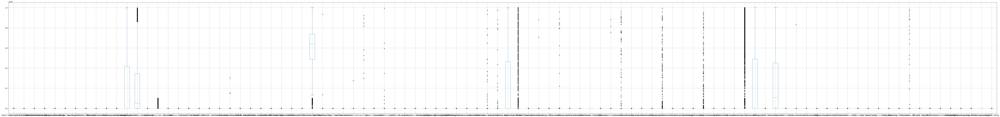

In [10]:
# Printing numeric columns and its count
num_cols = df_train_dup._get_numeric_data().columns 
display(num_cols)
print("Count: ", len(num_cols))

# Drawing box plots to check for outliers
plt.figure(figsize = (130,15))
df_train_dup.boxplot()
# Drawing box plots to check for outliers
#plt.figure(figsize = (50,50))
#for i in enumerate(num_cols):
#    plt.subplot(13,3,i[0]+1)
#    sns.boxplot(x=df_train_dup[i[1]],color='lightgreen')
#    sns.swarmplot(x=df_train_dup[i[1]],color='skyblue')
#    plt.xlabel(i[1])

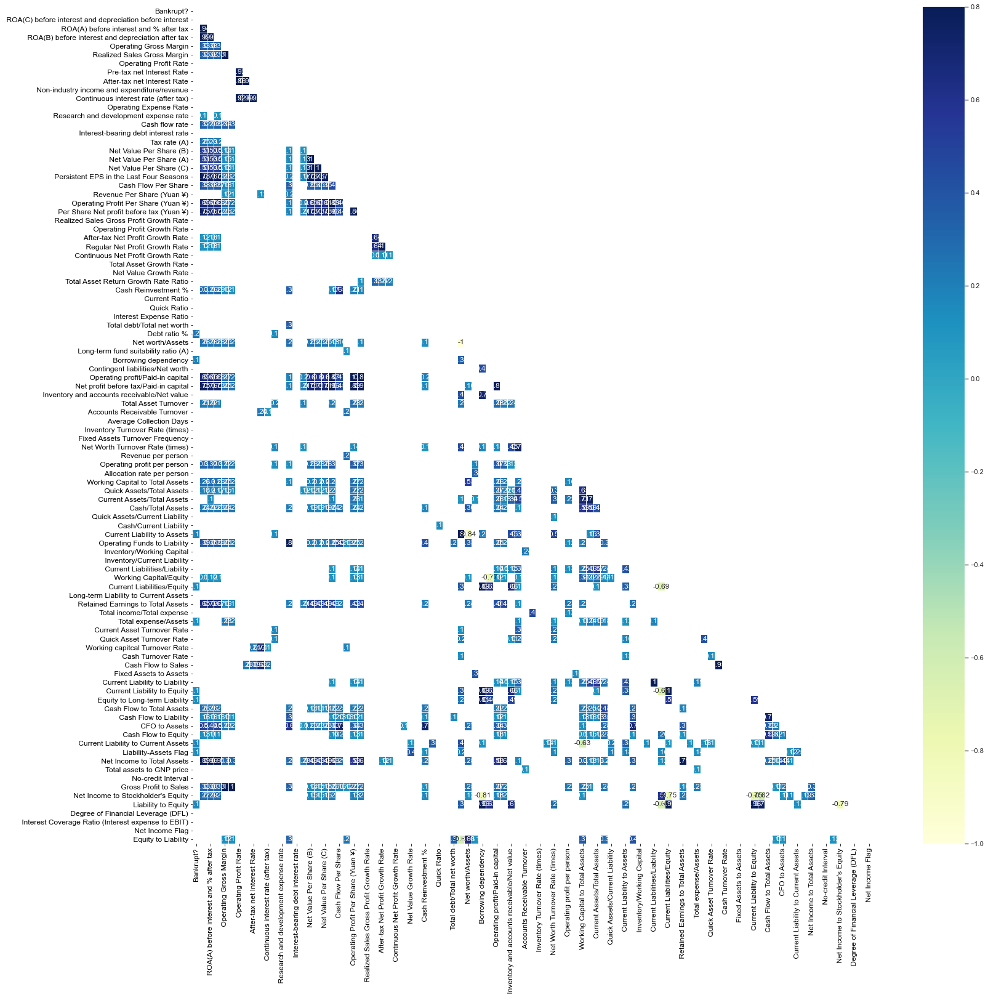

In [11]:
# Checking the Correlation variables
corrmat = df_train_dup.corr()
fig, ax = plt.subplots(figsize=(25,25))  
matrix = np.triu(df_train_dup.corr())
color = sns.color_palette("YlGnBu", as_cmap=True)
sns.set(font_scale=1)
sns.heatmap(corrmat[(corrmat >= 0.1) | (corrmat <= -0.6)], annot=True,vmax=.8, mask=matrix, ax=ax,cmap = color,linewidths=0.1);

In [12]:
df_train_dup.corr()['Bankrupt?'][(df_train_dup.corr()['Bankrupt?']>0.1) & (df_train_dup.corr()['Bankrupt?']<1)]

 Debt ratio %                           0.250161
 Borrowing dependency                   0.176543
 Current Liability to Assets            0.194494
 Current Liabilities/Equity             0.153828
 Total expense/Assets                   0.139049
 Current Liability to Equity            0.153828
 Equity to Long-term Liability          0.139014
 Current Liability to Current Assets    0.171306
 Liability-Assets Flag                  0.139212
 Liability to Equity                    0.166812
Name: Bankrupt?, dtype: float64

In [13]:
df_train_dup.columns[0]

'Bankrupt?'

Correlation indicates, given data with bankruptcy variable has less correlation. 

In [14]:
ntrain = df_train_dup.shape[0]
y_train = df_train_dup['Bankrupt?'].values
df_train_dup=df_train_dup.drop(['Bankrupt?'], axis=1)
print("all_data size is : {}".format(df_train_dup.shape))

all_data size is : (6819, 95)


In [15]:
y_train

array([1, 1, 1, ..., 0, 0, 0])

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.256969e-04,0.0,0.458143,0.000725,0.0,0.147950,0.147950,0.147950,0.169141,0.311664,0.017560,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,4.980000e+09,0.000327,0.263100,0.363725,0.002259,0.001208,0.629951,0.021266,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,0.001814,0.003487,1.820926e-04,1.165007e-04,0.032903,0.034164,0.392913,0.037135,0.672775,0.166673,0.190643,0.004094,0.001997,1.473360e-04,0.147308,0.334015,0.276920,0.001036,0.676269,0.721275,0.339077,0.025592,0.903225,0.002022,0.064856,7.010000e+08,6.550000e+09,0.593831,4.580000e+08,0.671568,0.424206,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.897851e-04,0.0,0.461867,0.000647,0.0,0.182251,0.182251,0.182251,0.208944,0.318137,0.021144,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,6.110000e+09,0.000443,0.264516,0.376709,0.006016,0.004039,0.635172,0.012502,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.397725,0.064468,0.001286,0.004917,9.360000e+09,7.190000e+08,0.025484,0.006889,0.391590,0.

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,-2.217909,-2.045798,-2.400361,-0.383334,-0.382638,0.016456,-0.023516,-0.020165,-0.087479,-0.031281,-0.616334,-0.750713,-0.545256,-0.151921,-0.829388,-1.279247,-1.275228,-1.276147,-1.794106,-0.671081,-0.025697,-0.471371,-1.375150,-0.025299,0.019997,-0.012031,-0.012262,-0.010299,-0.182259,-0.013721,-0.119118,-0.769297,-0.012111,-0.034237,-0.092520,-0.026226,1.750845,-1.750845,-0.133505,0.959784,0.041865,-0.471275,-1.460495,-0.332027,-0.540344,-0.045967,-0.038333,-0.661726,-0.407123,-0.155185,-0.017024,-0.237123,-0.038222,-2.393729,-1.155833,-1.520572,-0.861820,-0.020937,-0.072818,1.126267,-0.563752,-0.045371,-0.095887,-0.412896,-1.245334,0.568487,-0.094979,-1.232594,-0.043610,1.314027,-0.175421,1.299751,-0.019619,-0.685397,0.003948,-0.012111,-0.412896,0.568487,0.558428,-0.257031,-0.108218,-1.247231,-0.206594,2.812493,-0.034272,-2.254317,-0.049491,-0.084274,-0.383465,-0.861611,0.680171,-0.060031,-0.098978,0.0,-0.622067
1,-0.673828,-0.311068,-0.598450,0.135068,0.136307,0.014671,0.014799,0.015966,-0.005957,0.009823,-0.616334,-0.750713,-0.326632,-0.151921,-0.829388,-0.251878,-0.250429,-0.251550,-0.597379,-0.303533,-0.025697,-0.550058,-0.435312,-0.027130,0.010035,0.039473,0.039663,-0.001930,0.207732,-0.013721,0.027847,-0.143117,-0.012111,-0.034237,0.372093,-0.026226,1.075727,-1.075727,-0.132282,0.129305,-0.010932,-0.548362,-0.

,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.258227e-14,0.000000,0.458143,7.323965e-13,0.0,0.147950,0.147950,0.147950,0.169141,0.311664,5.814497e-12,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,0.498498,3.504580e-14,0.263100,0.363725,8.214412e-13,1.308510e-13,0.629951,2.139429e-12,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,1.862304e-13,3.584136e-13,1.822749e-14,1.166173e-14,0.032903,3.877887e-12,0.392913,3.880387e-12,0.672775,0.166673,0.190643,0.004094,2.263913e-13,1.526798e-14,0.147308,0.334015,0.276920,1.045399e-13,0.676269,0.721275,0.339077,2.682638e-12,0.903225,0.002022,0.064856,7.010000e-02,6.550000e-01,0.593831,0.0458,0.671568,5.098627e-11,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0.0,0.716845,9.388432e-13,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,0.0,0.016469
1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.900751e-14,0.000000,0.461867,6.536007e-13,0.0,0.182251,0.182251,0.182251,0.208944,0.318137,7.001435e-12,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,0.611612,4.748554e-14,0.264516,0.376709,2.187711e-12,4.376345e-13,0.635172,1.257786e-12,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.39772

Plain data:
Scalled data:
Minmax scalled data:


<AxesSubplot:>

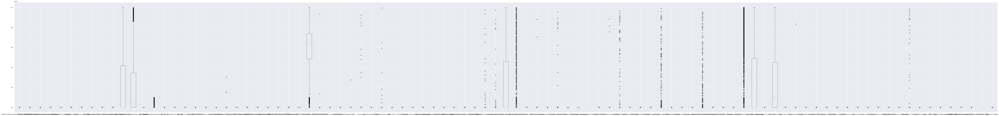

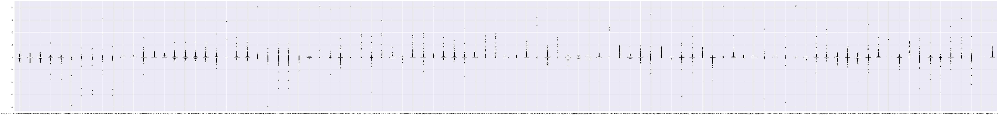

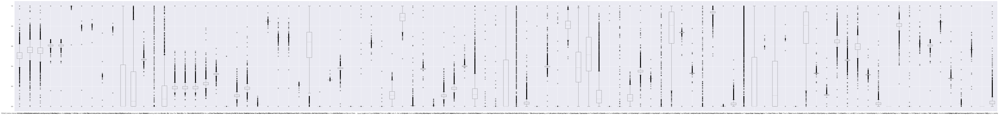

In [16]:
df_train_dup_scale = df_train_dup.copy()
df_train_dup_minmax = df_train_dup.copy()

df_train_dup_scale[df_train_dup_scale.columns]=preprocessing.scale(df_train_dup_scale[df_train_dup_scale.columns])

# define min max scaler
scaler = MinMaxScaler()
df_train_dup_minmax[df_train_dup_minmax.columns] = scaler.fit_transform(df_train_dup_minmax[df_train_dup_minmax.columns])

display(df_train_dup.head())
display(df_train_dup_scale.head())
display(df_train_dup_minmax.head())
print("Plain data:")
# Drawing box plots to check for outliers
plt.figure(figsize = (130,15))
df_train_dup.boxplot()
print("Scalled data:")
# Drawing box plots to check for outliers
plt.figure(figsize = (130,15))
df_train_dup_scale.boxplot()
print("Minmax scalled data:")
# Drawing box plots to check for outliers
plt.figure(figsize = (130,15))
df_train_dup_minmax.boxplot()

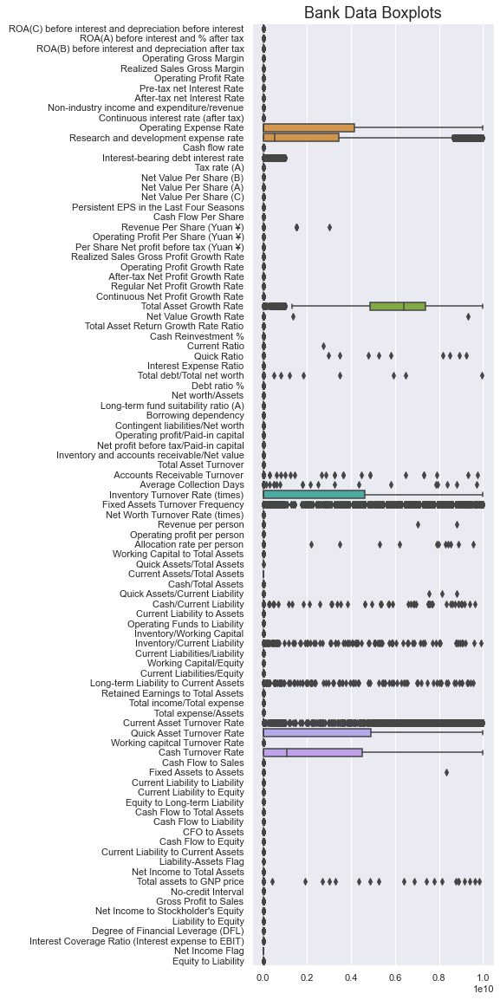

In [17]:
# Plotting Boxplots of the numerical features
plt.figure(figsize = (5,20))
ax =sns.boxplot(data = df_train_dup, orient="h")
ax.set_title('Bank Data Boxplots', fontsize = 18)
#ax.set(xscale="log")
plt.show()

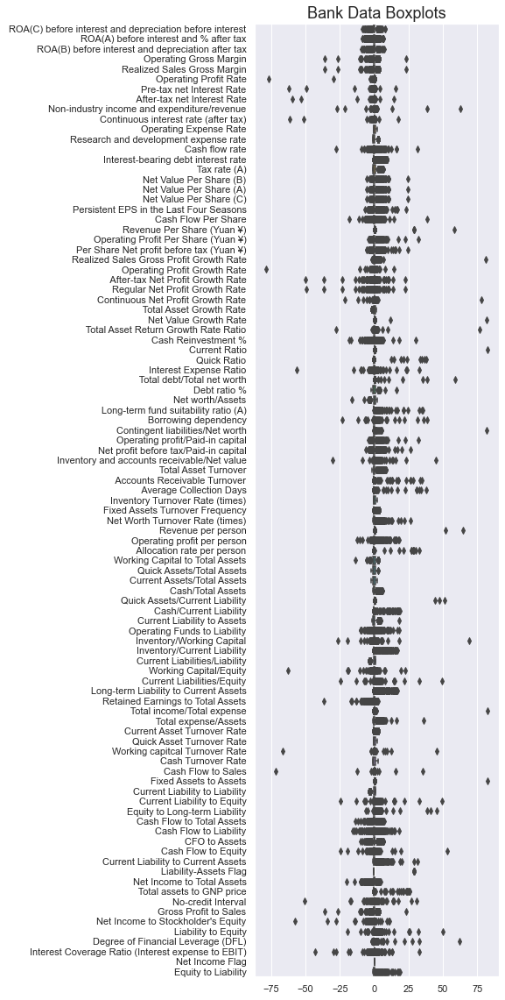

In [18]:
# Plotting Boxplots of the numerical features
plt.figure(num=2,figsize = (5,20))
ax =sns.boxplot(data = df_train_dup_scale, orient="h")
ax.set_title('Bank Data Boxplots', fontsize = 18)
#ax.set(xscale="log")
plt.show()

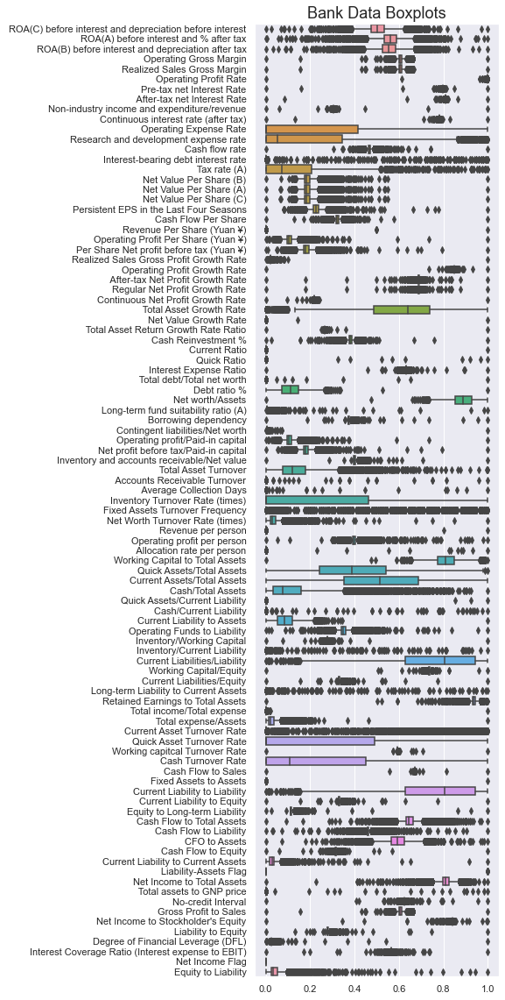

In [19]:
# Plotting Boxplots of the numerical features
plt.figure(num=2,figsize = (5,20))
ax =sns.boxplot(data = df_train_dup_minmax, orient="h")
ax.set_title('Bank Data Boxplots', fontsize = 18)
#ax.set(xscale="log")
plt.show()

In [20]:
#splitting data in to train and validation sets
df_train_dup_scale['Bankrupt?'] = y_train
# train-test 80-20 split
df_train_reg, df_test_reg = train_test_split(df_train_dup_scale, 
                                     train_size = 0.8, 
                                     test_size = 0.2, 
                                     random_state = 13)

# Divide into X_train, y_train, X_test, y_test
y_train_1 = df_train_reg.pop('Bankrupt?')
X_train_1 = df_train_reg

y_test_1 = df_test_reg.pop('Bankrupt?')
X_test_1 = df_test_reg

In [21]:
model_columns=X_train_1.columns
model_columns

Index([' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)', ' Operating Expense Rate',
       ' Research and development expense rate', ' Cash flow rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Net Value Per Share (B)', ' Net Value Per Share (A)',
       ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons',
       ' Cash Flow Per Share', ' Revenue Per Share (Yuan ¥)',
       ' Operating Profit Per Share (Yuan ¥)',
       ' Per Share Net profit before tax (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Operating Profit Growth Rate'

R^2 Scores:  [-6.51111886e-03 -8.23384291e+16  1.71340023e-01 -1.03657582e+00
 -1.21304698e+00 -2.97191431e+15  9.65896833e-02 -8.75388938e+00
 -3.62474501e+00 -1.80822833e+01]

RMSE Scores:  [-2.09703419e-01 -4.37465619e+07 -1.58105812e-01 -2.09227565e-01
 -2.43161920e-01 -9.47682937e+06 -1.55499711e-01 -4.19149837e-01
 -4.32361050e-01 -8.21321736e-01]
Coefficients= [ 6.32047925e-02  8.12004725e-02 -9.64167518e-02  1.84231283e+00
 -9.85170400e-02 -4.67239358e+02  3.86134868e+02  6.83625735e-03
 -1.91668934e+02 -1.02006664e-01  5.28955143e-04  2.68746262e-03
 -3.43323588e-03  1.81417650e-03 -1.09878312e-02 -4.81276082e-02
 -1.38931147e-01  1.86802957e-01 -8.08453751e-03 -1.87807563e-03
 -6.59858356e-03 -4.57152828e-02  4.83083250e-03  1.20721825e-03
 -5.55868155e-03  1.11172659e-02 -5.44944945e-03  6.64525690e-04
 -8.48054175e-04  2.28396381e-03  4.71696511e-05  1.69058120e-03
 -2.79952847e-03  1.13690565e-03  8.00111836e-04  1.96314605e-03
  3.73663752e+11  3.73663752e+11  5.11680396e

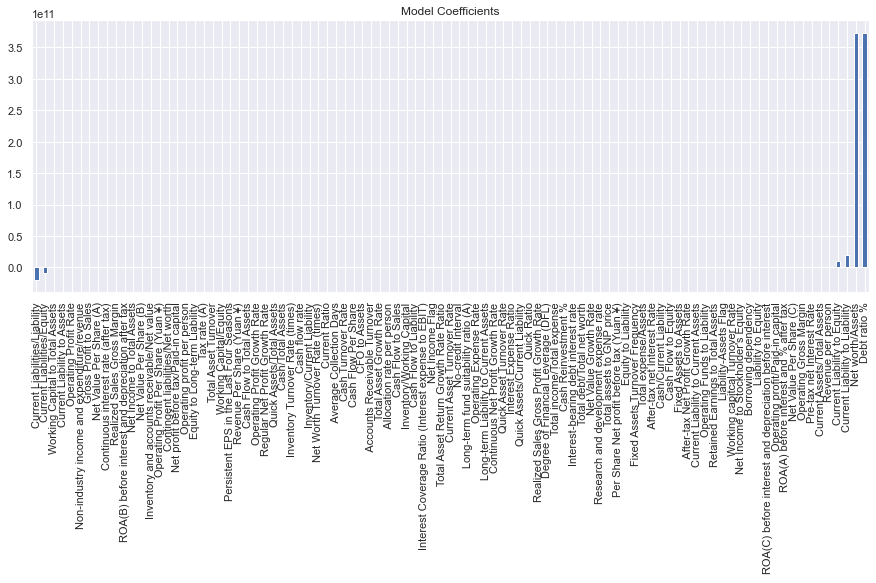

In [22]:
#Basic linear regression
model = LinearRegression()
model.fit(X_train_1, y_train_1)
predicted_prices_regr = model.predict(X_test_1)

#RMSE
rmse = mean_squared_error(y_test_1, predicted_prices_regr, squared=False)
rmse

# create a KFold object with 10 splits 
folds = KFold(n_splits = 10, shuffle = True, random_state = 13)
scores = cross_val_score(model, X_train_1, y_train_1, scoring='r2', cv=folds)
print("R^2 Scores: ",scores)

# create a KFold object with 10 splits 
folds = KFold(n_splits = 10, shuffle = True, random_state = 13)
scores = cross_val_score(model, X_train_1, y_train_1, scoring='neg_root_mean_squared_error', cv=folds)
print("")
print("RMSE Scores: ",scores)  
# Let us explore the coefficients for each of the independent attributes
print("Coefficients=",model.coef_)
#checking the magnitude of coefficients
predictors = X_train_1.columns
coef = pd.Series(model.coef_.flatten(), predictors).sort_values()
coef.plot(kind='bar', title='Model Coefficients', figsize=(15,5));
# R square on training data
print("R square on training data:",model.score(X_train_1, y_train_1))
print("R square on training data:",model.score(X_test_1, y_test_1))
RMSE_lr_train = metrics.mean_squared_error(y_true = y_train_1, y_pred=model.predict(X_train_1),squared=False)
RMSE_lr_test = metrics.mean_squared_error(y_true = y_test_1, y_pred=model.predict(X_test_1), squared=False)
resultsDf = pd.DataFrame({'Train RMSE': [RMSE_lr_train],'Test RMSE': [RMSE_lr_test]},index=['LinearRegression'])
print(resultsDf)

In [23]:
#SVM regression
svc = SVC()
param_svc = {'C':[1,2,3,4,5],'kernel':['linear', 'poly', 'rbf', 'sigmoid'],'degree':[3,4,5]}

#svc_gridsearch = GridSearchCV(estimator=svc,param_grid=param_svc,cv=LeaveOneOut(),scoring='recall',n_jobs=-1)
svc_gridsearch = GridSearchCV(estimator=svc,param_grid=param_svc,cv=3,scoring='recall',n_jobs=-1)
svc_gridsearch.fit(X_train_1,y_train_1)
print(svc_gridsearch.best_params_)
print(svc_gridsearch.best_estimator_.score(X_train_1,y_train_1))
print(svc_gridsearch.best_estimator_.score(X_test_1,y_test_1))
## Performance Matrix on test data set
y_pred_svm=svc_gridsearch.best_estimator_.predict(X_test_1)
print(metrics.classification_report(y_true=y_test_1,y_pred=y_pred_svm))

{'C': 4, 'degree': 3, 'kernel': 'sigmoid'}
0.9563703024747938
0.9479472140762464
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      1311
           1       0.28      0.21      0.24        53

    accuracy                           0.95      1364
   macro avg       0.62      0.59      0.60      1364
weighted avg       0.94      0.95      0.94      1364



In [24]:
#Logistic Regression
LR = LogisticRegression(max_iter=100000000000)
## Training data score and model fitting
LR.fit(X_train_1,y_train_1)
LR.score(X_train_1,y_train_1)

0.9747021081576536

In [25]:
## Test data scoring
LR.score(X_test_1,y_test_1)

0.9574780058651027

In [26]:
parameters = {'penalty':['l1', 'l2', 'elasticnet', 'none'],'C':[1,2,3,4,5,6]}

In [27]:
#LR_tune = GridSearchCV(estimator=LR,param_grid=parameters,cv=LeaveOneOut(),n_jobs=-1)
LR_tune = GridSearchCV(estimator=LR,param_grid=parameters,cv=3,n_jobs=-1)
LR_tune.fit(X_train_1,y_train_1)

GridSearchCV(cv=3, estimator=LogisticRegression(max_iter=100000000000),
             n_jobs=-1,
             param_grid={'C': [1, 2, 3, 4, 5, 6],
                         'penalty': ['l1', 'l2', 'elasticnet', 'none']})

In [28]:
LR_tune.best_params_

{'C': 1, 'penalty': 'l2'}

In [29]:
LR_tune.best_estimator_.score(X_train_1,y_train_1)

0.9747021081576536

In [30]:
y_pred_train_lr=LR_tune.best_estimator_.predict(X_train_1)
metrics.confusion_matrix(y_true=y_train_1,y_pred=y_pred_train_lr)

array([[5270,   18],
       [ 120,   47]])

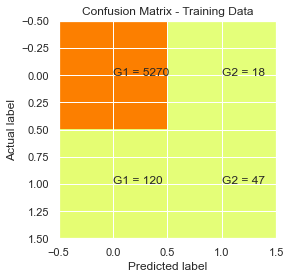

In [31]:
cm = metrics.confusion_matrix(y_true=y_train_1,y_pred=y_pred_train_lr)
plt.clf()
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Wistia)
plt.title('Confusion Matrix - Training Data')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

s = [['G1', 'G2'], ['G1','G2']]
 
for i in range(2):
    for j in range(2):
        plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))
plt.show()

In [32]:
## Model evaluation on the test data
y_pred_lr=LR_tune.best_estimator_.predict(X_test_1)
print(metrics.classification_report(y_true=y_test_1,y_pred=y_pred_lr))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1311
           1       0.39      0.17      0.24        53

    accuracy                           0.96      1364
   macro avg       0.68      0.58      0.61      1364
weighted avg       0.94      0.96      0.95      1364



In [33]:
#Gaussian Naive Bayes
GNB_model = GaussianNB()
#BN_NB = BernoulliNB()
m_3 = GNB_model.fit(X_train_1,y_train_1)
y_pred_train_gnb = m_3.predict(X_train_1)
model_score = m_3.score(X_train_1, y_train_1)                      ## Accuracy
print(model_score)
print(metrics.confusion_matrix(y_train_1, y_pred_train_gnb))          ## confusion_matrix
print(metrics.classification_report(y_train_1, y_pred_train_gnb))     ## classification_report

0.4672777268560953
[[2393 2895]
 [  11  156]]
              precision    recall  f1-score   support

           0       1.00      0.45      0.62      5288
           1       0.05      0.93      0.10       167

    accuracy                           0.47      5455
   macro avg       0.52      0.69      0.36      5455
weighted avg       0.97      0.47      0.61      5455



In [34]:
## Performance Matrix on test data set
y_pred_gnb = m_3.predict(X_test_1)
model_score = m_3.score(X_test_1, y_test_1)                    ## Accuracy
print(model_score)
print(metrics.confusion_matrix(y_test_1, y_pred_gnb))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_gnb))    ## classification_report

0.4838709677419355
[[612 699]
 [  5  48]]
              precision    recall  f1-score   support

           0       0.99      0.47      0.63      1311
           1       0.06      0.91      0.12        53

    accuracy                           0.48      1364
   macro avg       0.53      0.69      0.38      1364
weighted avg       0.96      0.48      0.61      1364



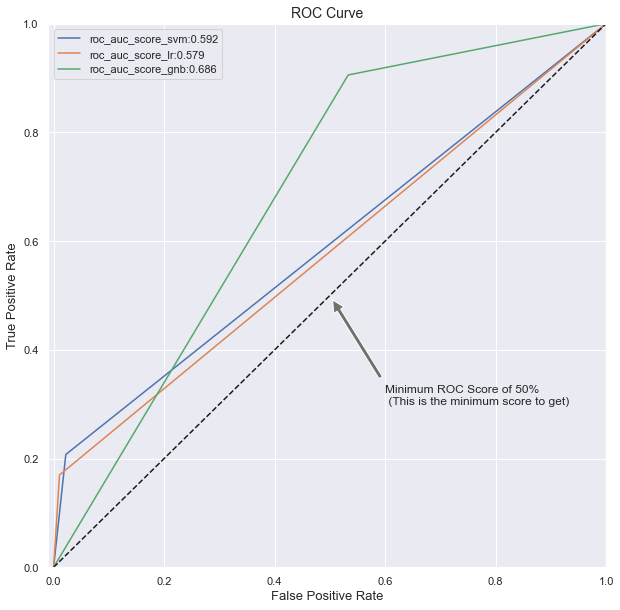

In [35]:
#ROC curve
svm_fpr, svm_tpr, svm_threshold = roc_curve(y_test_1, y_pred_svm)
lr_fpr, lr_tpr, lr_thresold = roc_curve(y_test_1, y_pred_lr)
gnb_fpr, gnb_tpr, gnb_thresold = roc_curve(y_test_1, y_pred_gnb)
roc_auc_score_svm=roc_auc_score(y_test_1, y_pred_svm)
roc_auc_score_lr=roc_auc_score(y_test_1, y_pred_lr)
roc_auc_score_gnb=roc_auc_score(y_test_1, y_pred_gnb)

def graph_roc_curve_multiple(svm_fpr, svm_tpr,lr_fpr, lr_tpr,gnb_fpr, gnb_tpr):
    plt.figure(figsize=(10,10))
    plt.title('ROC Curve', fontsize=14)
    plt.plot(svm_fpr, svm_tpr, label='roc_auc_score_svm:%.5s' % roc_auc_score_svm)
    plt.plot(lr_fpr, lr_tpr, label='roc_auc_score_lr:%.5s' % roc_auc_score_lr)
    plt.plot(gnb_fpr, gnb_tpr, label='roc_auc_score_gnb:%.5s' % roc_auc_score_gnb)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.axis([-0.01, 1, 0, 1])
    plt.xlabel('False Positive Rate', fontsize=13)
    plt.ylabel('True Positive Rate', fontsize=13)
    plt.annotate('Minimum ROC Score of 50% \n (This is the minimum score to get)', xy=(0.5, 0.5), xytext=(0.6, 0.3),
                arrowprops=dict(facecolor='#6E726D', shrink=0.05),
                )
    plt.legend()
    
graph_roc_curve_multiple(svm_fpr, svm_tpr,lr_fpr, lr_tpr,gnb_fpr, gnb_tpr)
plt.show()

In [36]:
def evaluate_model(ground_truth, predictions):

  f1 = f1_score(ground_truth, predictions)
  precision = precision_score(ground_truth, predictions)
  recall = recall_score(ground_truth, predictions)
  accuracy = accuracy_score(ground_truth, predictions)

  print("F1 Score: {}".format(f1))
  print("Precision Score: {}".format(precision))
  print("Recall Score: {}".format(recall))
  print("Accuracy Score: {}".format(accuracy))

F1 Score: 0.2608695652173913
Precision Score: 0.5625
Recall Score: 0.16981132075471697
Accuracy Score: 0.9626099706744868
DecisionTreeClassifier(criterion='entropy', max_features='auto',
                       random_state=390123814)
n_nodes=191
[[1304    7]
 [  44    9]]
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1311
           1       0.56      0.17      0.26        53

    accuracy                           0.96      1364
   macro avg       0.76      0.58      0.62      1364
weighted avg       0.95      0.96      0.95      1364



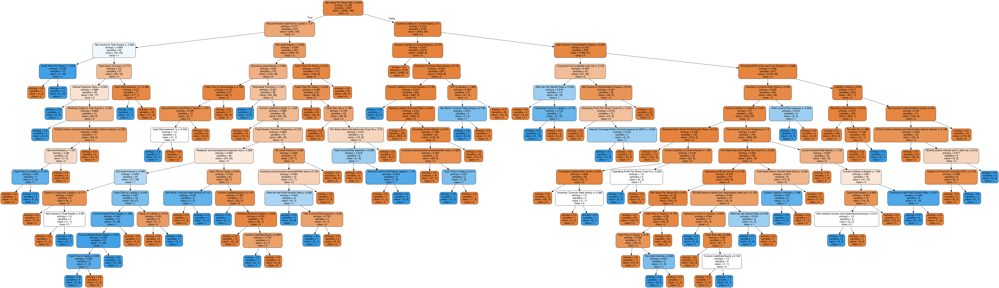

In [37]:
#Ramdom forest with entropy
rf = RandomForestClassifier(n_estimators=100, criterion="entropy")
# Train model
rfc= rf.fit(X_train_1, y_train_1)
## Performance Matrix on test data set
y_pred_rfc_e = rfc.predict(X_test_1)
evaluate_model(list(y_test_1), list(y_pred_rfc_e))
#extract single tree
estimator = rfc.estimators_[5]
print(estimator)
n_nodes = rfc.estimators_[0].tree_.node_count
print("n_nodes={}".format(n_nodes))
print(metrics.confusion_matrix(y_test_1, y_pred_rfc_e))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_rfc_e))    ## classification_report
#Visualize graph
dot_data = StringIO()
export_graphviz(estimator, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names = model_columns,
                class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('RandomForestClassifer_bankruptcy_entropy.png')
Image(graph.create_png())

F1 Score: 0.2985074626865672
Precision Score: 0.7142857142857143
Recall Score: 0.18867924528301888
Accuracy Score: 0.9655425219941349
DecisionTreeClassifier(criterion='entropy', max_depth=200, max_features='auto',
                       random_state=1344478839)
n_nodes=199
[[1307    4]
 [  43   10]]
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1311
           1       0.71      0.19      0.30        53

    accuracy                           0.97      1364
   macro avg       0.84      0.59      0.64      1364
weighted avg       0.96      0.97      0.96      1364



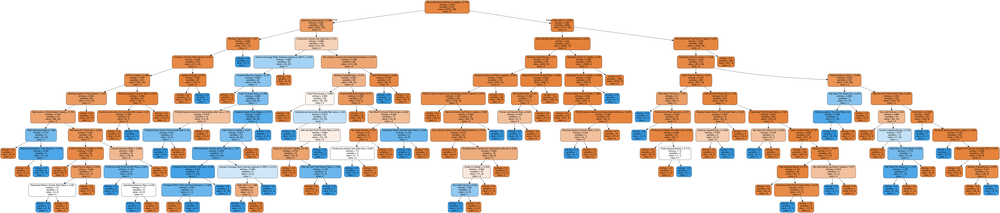

In [38]:
#Ramdom forest with entropy and other
rf = RandomForestClassifier(n_estimators=100,max_features='auto',max_depth=200,criterion="entropy")
# Train model
rfc= rf.fit(X_train_1, y_train_1)
## Performance Matrix on test data set
y_pred_rfc_e = rfc.predict(X_test_1)
evaluate_model(list(y_test_1), list(y_pred_rfc_e))
#extract single tree
estimator = rfc.estimators_[5]
print(estimator)
n_nodes = rfc.estimators_[0].tree_.node_count
print("n_nodes={}".format(n_nodes))
print(metrics.confusion_matrix(y_test_1, y_pred_rfc_e))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_rfc_e))    ## classification_report
#Visualize graph
dot_data = StringIO()
export_graphviz(estimator, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names = model_columns,
                class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('RandomForestClassifer_bankruptcy_depth_entropy.png')
Image(graph.create_png())

F1 Score: 0.28125
Precision Score: 0.8181818181818182
Recall Score: 0.16981132075471697
Accuracy Score: 0.966275659824047
DecisionTreeClassifier(criterion='entropy', max_depth=200, max_features='log2',
                       random_state=961314056)
n_nodes=225
[[1309    2]
 [  44    9]]
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1311
           1       0.82      0.17      0.28        53

    accuracy                           0.97      1364
   macro avg       0.89      0.58      0.63      1364
weighted avg       0.96      0.97      0.96      1364



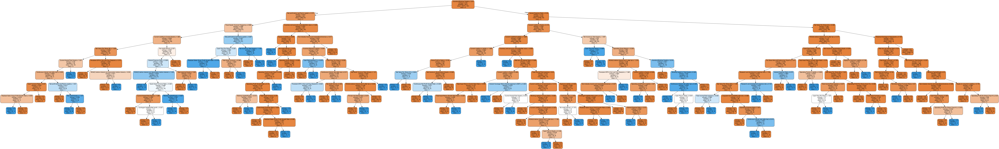

In [39]:
#Ramdom forest with entropy and other
rf = RandomForestClassifier(n_estimators=100,max_features='log2',max_depth=200,criterion="entropy")
# Train model
rfc= rf.fit(X_train_1, y_train_1)
## Performance Matrix on test data set
y_pred_rfc_e = rfc.predict(X_test_1)
evaluate_model(list(y_test_1), list(y_pred_rfc_e))
#extract single tree
estimator = rfc.estimators_[5]
print(estimator)
n_nodes = rfc.estimators_[0].tree_.node_count
print("n_nodes={}".format(n_nodes))
print(metrics.confusion_matrix(y_test_1, y_pred_rfc_e))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_rfc_e))    ## classification_report
#Visualize graph
dot_data = StringIO()
export_graphviz(estimator, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names = model_columns,
                class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('RandomForestClassifer_bankruptcy_maxFeatu_entropy.png')
Image(graph.create_png())

F1 Score: 0.368421052631579
Precision Score: 0.6086956521739131
Recall Score: 0.2641509433962264
Accuracy Score: 0.9648093841642229
DecisionTreeClassifier(max_features='auto', random_state=799606991)
n_nodes=239
[[1302    9]
 [  39   14]]
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1311
           1       0.61      0.26      0.37        53

    accuracy                           0.96      1364
   macro avg       0.79      0.63      0.68      1364
weighted avg       0.96      0.96      0.96      1364



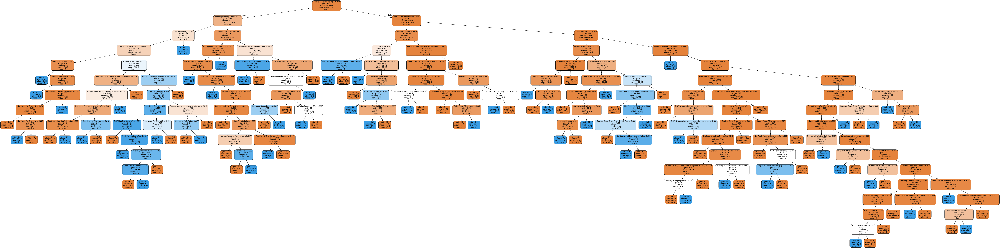

In [40]:
#Ramdom forest with gini index
rf = RandomForestClassifier(n_estimators=100, criterion="gini")
# Train model
rfc= rf.fit(X_train_1, y_train_1)
## Performance Matrix on test data set
y_pred_rfc_g = rfc.predict(X_test_1)
evaluate_model(list(y_test_1), list(y_pred_rfc_g))
#extract single tree
estimator = rfc.estimators_[5]
print(estimator)
n_nodes = rfc.estimators_[0].tree_.node_count
print("n_nodes={}".format(n_nodes))
print(metrics.confusion_matrix(y_test_1, y_pred_rfc_g))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_rfc_g))    ## classification_report
#Visualize graph
dot_data = StringIO()
export_graphviz(estimator, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names = model_columns,
                class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('RandomForestClassifer_bankruptcy_gini.png')
Image(graph.create_png())

In [41]:
#Gradient Boosted Trees
gb = GradientBoostingClassifier()
gbt = gb.fit(X_train_1, y_train_1)
# evaluate the model
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(gbt, X_train_1, y_train_1, scoring='accuracy', cv=cv, n_jobs=-1, error_score='raise')
#print('Accuracy: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))
print('Accuracy:',n_scores)
## Performance Matrix on test data set
y_pred_gbt = gbt.predict(X_test_1)
evaluate_model(list(y_test_1), list(y_pred_gbt))
print(metrics.confusion_matrix(y_test_1, y_pred_gbt))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_gbt))    ## classification_report

Accuracy: [0.96886447 0.96153846 0.96703297 0.97435897 0.96703297 0.9706422
 0.97798165 0.9706422  0.97247706 0.96513761 0.96520147 0.96886447
 0.96703297 0.96703297 0.97069597 0.96330275 0.96513761 0.96880734
 0.96513761 0.96697248 0.96886447 0.97252747 0.97069597 0.97435897
 0.97069597 0.96880734 0.9706422  0.9706422  0.96330275 0.96697248]
F1 Score: 0.3950617283950617
Precision Score: 0.5714285714285714
Recall Score: 0.3018867924528302
Accuracy Score: 0.9640762463343109
[[1299   12]
 [  37   16]]
              precision    recall  f1-score   support

           0       0.97      0.99      0.98      1311
           1       0.57      0.30      0.40        53

    accuracy                           0.96      1364
   macro avg       0.77      0.65      0.69      1364
weighted avg       0.96      0.96      0.96      1364



In [53]:
#Decison Trees with gini index
stump = DecisionTreeClassifier(max_depth = 100, splitter = "random", max_features = "sqrt",criterion="gini")
# Create Extra Trees
ensemble = BaggingClassifier(base_estimator = stump, n_estimators = 1000,
                             bootstrap = False)
# Training classifiers
stump_fit = stump.fit(X_train_1, np.ravel(y_train_1))
ensemble_fit = ensemble.fit(X_train_1, np.ravel(y_train_1))
# Making predictions
y_pred_tree_g = stump_fit.predict(X_test_1)
y_pred_ensemble_g = ensemble_fit.predict(X_test_1)
# Determine performance
stump_accuracy = metrics.accuracy_score(y_test_1, y_pred_tree_g)
ensemble_accuracy = metrics.accuracy_score(y_test_1, y_pred_ensemble_g)
# Print message to user
print(f"The accuracy of the stump is {stump_accuracy*100:.1f} %")
print(f"The accuracy of the Extra Trees is {ensemble_accuracy*100:.1f} %")
## Performance Matrix on test data set
evaluate_model(list(y_test_1), list(y_pred_tree_g))
evaluate_model(list(y_test_1), list(y_pred_ensemble_g))
print(metrics.confusion_matrix(y_test_1, y_pred_tree_g))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_tree_g))    ## classification_report
print(metrics.confusion_matrix(y_test_1, y_pred_ensemble_g))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_ensemble_g))    ## classification_report
#Visualize graph
estimator = ensemble_fit.estimators_[5]
dot_data = StringIO()
export_graphviz(estimator, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names = model_columns,
                class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('DecisionTree_bankruptcy_gini.png')
Image(graph.create_png())

The accuracy of the stump is 94.3 %
The accuracy of the Extra Trees is 96.4 %
F1 Score: 0.25
Precision Score: 0.2549019607843137
Recall Score: 0.24528301886792453
Accuracy Score: 0.9428152492668622
F1 Score: 0.24615384615384617
Precision Score: 0.6666666666666666
Recall Score: 0.1509433962264151
Accuracy Score: 0.9640762463343109
[[1273   38]
 [  40   13]]
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1311
           1       0.25      0.25      0.25        53

    accuracy                           0.94      1364
   macro avg       0.61      0.61      0.61      1364
weighted avg       0.94      0.94      0.94      1364

[[1307    4]
 [  45    8]]
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1311
           1       0.67      0.15      0.25        53

    accuracy                           0.96      1364
   macro avg       0.82      0.57      0.61      1364
weighted avg   

In [54]:
#Decision Trees with entropy
stump = DecisionTreeClassifier(max_depth = 100, splitter = "random", max_features = "sqrt", criterion="entropy")
# Create Extra Trees
ensemble = BaggingClassifier(base_estimator = stump, n_estimators = 1000,
                             bootstrap = False)
# Training classifiers
stump_fit = stump.fit(X_train_1, np.ravel(y_train_1))
ensemble_fit = ensemble.fit(X_train_1, np.ravel(y_train_1))
# Making predictions
y_pred_tree_e = stump_fit.predict(X_test_1)
y_pred_ensemble_e = ensemble_fit.predict(X_test_1)
# Determine performance
stump_accuracy = metrics.accuracy_score(y_test_1, y_pred_tree_e)
ensemble_accuracy = metrics.accuracy_score(y_test_1, y_pred_ensemble_e)
# Print message to user
print(f"The accuracy of the stump is {stump_accuracy*100:.1f} %")
print(f"The accuracy of the Extra Trees is {ensemble_accuracy*100:.1f} %")
## Performance Matrix on test data set
evaluate_model(list(y_test_1), list(y_pred_tree_e))
evaluate_model(list(y_test_1), list(y_pred_ensemble_e))
print(metrics.confusion_matrix(y_test_1, y_pred_tree_g))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_tree_g))    ## classification_report
print(metrics.confusion_matrix(y_test_1, y_pred_ensemble_g))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_ensemble_g))    ## classification_report
#Visualize graph
estimator = ensemble_fit.estimators_[5]
dot_data = StringIO()
export_graphviz(estimator, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names = model_columns,
                class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('DecisionTree_bankruptcy_entropy.png')
Image(graph.create_png())

The accuracy of the stump is 94.9 %
The accuracy of the Extra Trees is 96.5 %
F1 Score: 0.3
Precision Score: 0.3191489361702128
Recall Score: 0.2830188679245283
Accuracy Score: 0.9486803519061584
F1 Score: 0.27272727272727276
Precision Score: 0.6923076923076923
Recall Score: 0.16981132075471697
Accuracy Score: 0.9648093841642229
[[1273   38]
 [  40   13]]
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1311
           1       0.25      0.25      0.25        53

    accuracy                           0.94      1364
   macro avg       0.61      0.61      0.61      1364
weighted avg       0.94      0.94      0.94      1364

[[1307    4]
 [  45    8]]
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1311
           1       0.67      0.15      0.25        53

    accuracy                           0.96      1364
   macro avg       0.82      0.57      0.61      1364
weighted avg    

In [55]:
#Extra Trees with entropy
et = ExtraTreesClassifier(max_depth = 1000, max_features = "sqrt", criterion="entropy")
# Training classifiers
etc = et.fit(X_train_1, np.ravel(y_train_1))
# Making predictions
y_pred_etc = etc.predict(X_test_1)

# Determine performance
etc_accuracy = metrics.accuracy_score(y_test_1, y_pred_etc)

# Print message to user
print(f"The accuracy of the stump is {stump_accuracy*100:.1f} %")
print(f"The accuracy of the Extra Trees is {ensemble_accuracy*100:.1f} %")
## Performance Matrix on test data set
evaluate_model(list(y_test_1), list(y_pred_etc))

print(metrics.confusion_matrix(y_test_1, y_pred_etc))         ## confusion_matrix
print(metrics.classification_report(y_test_1, y_pred_etc))    ## classification_report

#Visualize graph
estimator = etc.estimators_[5]
dot_data = StringIO()
export_graphviz(estimator, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,
                feature_names = model_columns,
                class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('ExtrTree_bankruptcy_entropy.png')
Image(graph.create_png())

The accuracy of the stump is 94.9 %
The accuracy of the Extra Trees is 96.5 %
F1 Score: 0.22580645161290322
Precision Score: 0.7777777777777778
Recall Score: 0.1320754716981132
Accuracy Score: 0.9648093841642229
[[1309    2]
 [  46    7]]
              precision    recall  f1-score   support

           0       0.97      1.00      0.98      1311
           1       0.78      0.13      0.23        53

    accuracy                           0.96      1364
   macro avg       0.87      0.57      0.60      1364
weighted avg       0.96      0.96      0.95      1364



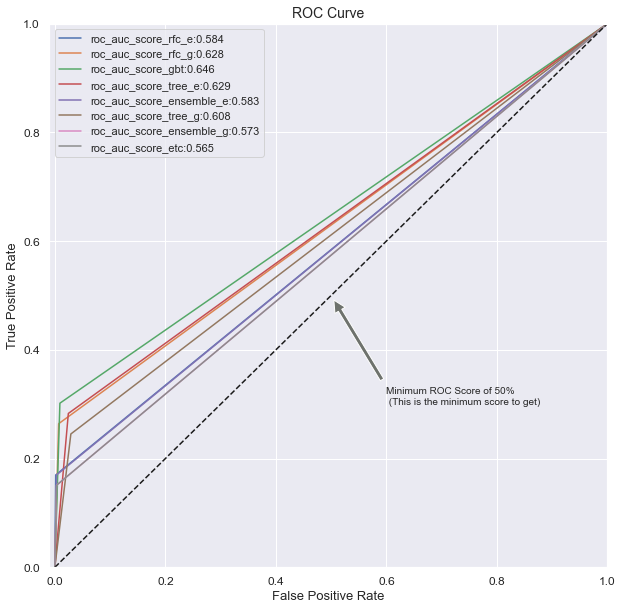

In [56]:
#ROC curve
rfc_e_fpr, rfc_e_tpr, rfc_e_threshold = roc_curve(y_test_1, y_pred_rfc_e)
rfc_g_fpr, rfc_g_tpr, rfc_g_thresold = roc_curve(y_test_1, y_pred_rfc_g)
gbt_fpr, gbt_tpr, gbt_thresold = roc_curve(y_test_1, y_pred_gbt)
tree_e_fpr, tree_e_tpr, tree_e_thresold = roc_curve(y_test_1, y_pred_tree_e)
ensemble_e_fpr, ensemble_e_tpr, ensemble_e_thresold = roc_curve(y_test_1, y_pred_ensemble_e)
tree_g_fpr, tree_g_tpr, tree_g_thresold = roc_curve(y_test_1, y_pred_tree_g)
ensemble_g_fpr, ensemble_g_tpr, ensemble_g_thresold = roc_curve(y_test_1, y_pred_ensemble_g)
etc_fpr, etc_tpr, etc_thresold = roc_curve(y_test_1, y_pred_etc)

roc_auc_score_rfc_e=roc_auc_score(y_test_1, y_pred_rfc_e)
roc_auc_score_rfc_g=roc_auc_score(y_test_1, y_pred_rfc_g)
roc_auc_score_gbt=roc_auc_score(y_test_1, y_pred_gbt)
roc_auc_score_tree_e=roc_auc_score(y_test_1, y_pred_tree_e)
roc_auc_score_ensemble_e=roc_auc_score(y_test_1, y_pred_ensemble_e)
roc_auc_score_tree_g=roc_auc_score(y_test_1, y_pred_tree_g)
roc_auc_score_ensemble_g=roc_auc_score(y_test_1, y_pred_ensemble_g)
roc_auc_score_etc=roc_auc_score(y_test_1, y_pred_etc)

def graph_roc_curve_multiple(rfc_e_fpr, rfc_e_tpr, 
                             rfc_g_fpr, rfc_g_tpr, 
                             gbt_fpr, gbt_tpr, 
                             tree_e_fpr, tree_e_tpr, 
                             ensemble_e_fpr, ensemble_e_tpr, 
                             tree_g_fpr, tree_g_tpr, 
                             ensemble_g_fpr, ensemble_g_tpr,
                             etc_fpr, etc_tpr):
    plt.figure(figsize=(10,10))
    plt.title('ROC Curve', fontsize=14)
    plt.plot(rfc_e_fpr, rfc_e_tpr, label='roc_auc_score_rfc_e:%.5s' % roc_auc_score_rfc_e)
    plt.plot(rfc_g_fpr, rfc_g_tpr, label='roc_auc_score_rfc_g:%.5s' % roc_auc_score_rfc_g)
    plt.plot(gbt_fpr, gbt_tpr, label='roc_auc_score_gbt:%.5s' % roc_auc_score_gbt)
    plt.plot(tree_e_fpr, tree_e_tpr, label='roc_auc_score_tree_e:%.5s' % roc_auc_score_tree_e)
    plt.plot(ensemble_e_fpr, ensemble_e_tpr, label='roc_auc_score_ensemble_e:%.5s' % roc_auc_score_ensemble_e)
    plt.plot(tree_g_fpr, tree_g_tpr, label='roc_auc_score_tree_g:%.5s' % roc_auc_score_tree_g)
    plt.plot(ensemble_g_fpr, ensemble_g_tpr, label='roc_auc_score_ensemble_g:%.5s' % roc_auc_score_ensemble_g)
    plt.plot(ensemble_g_fpr, ensemble_g_tpr, label='roc_auc_score_etc:%.5s' % roc_auc_score_etc)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.axis([-0.01, 1, 0, 1])
    plt.xlabel('False Positive Rate', fontsize=13)
    plt.ylabel('True Positive Rate', fontsize=13)
    plt.annotate('Minimum ROC Score of 50% \n (This is the minimum score to get)', xy=(0.5, 0.5), xytext=(0.6, 0.3),
                arrowprops=dict(facecolor='#6E726D', shrink=0.05),
                )
    plt.legend()
    
graph_roc_curve_multiple(rfc_e_fpr, rfc_e_tpr,
                         rfc_g_fpr, rfc_g_tpr,
                         gbt_fpr, gbt_tpr,
                         tree_e_fpr, tree_e_tpr,
                         ensemble_e_fpr, ensemble_e_tpr,
                         tree_g_fpr, tree_g_tpr,
                         ensemble_g_fpr, ensemble_g_tpr,
                         etc_fpr, etc_tpr)
plt.show()